In [ ]:
#!pip install pyautogui

In [1]:
from PIL import ImageGrab
import pyautogui
import win32gui
import time
import numpy as np
from IPython.display import clear_output
import re
import requests
import lxml.html as lh

In [2]:
def screenshot(window_title=None):
    if window_title:
        hwnd = win32gui.FindWindow(None, window_title)
        if hwnd:
            win32gui.SetForegroundWindow(hwnd)
            x, y, x1, y1 = win32gui.GetClientRect(hwnd)
            x, y = win32gui.ClientToScreen(hwnd, (x, y))
            x1, y1 = win32gui.ClientToScreen(hwnd, (x1 - x, y1 - y))
            im = pyautogui.screenshot(region=(x, y, x1, y1))
            return im
        else:
            print('Window not found!')
    else:
        im = pyautogui.screenshot()
        return im


# im = screenshot('PM 100000.00 NLHE Spin & Go - 30/60 - Tournament 2899858582 Table 1')
# if im:
#     im

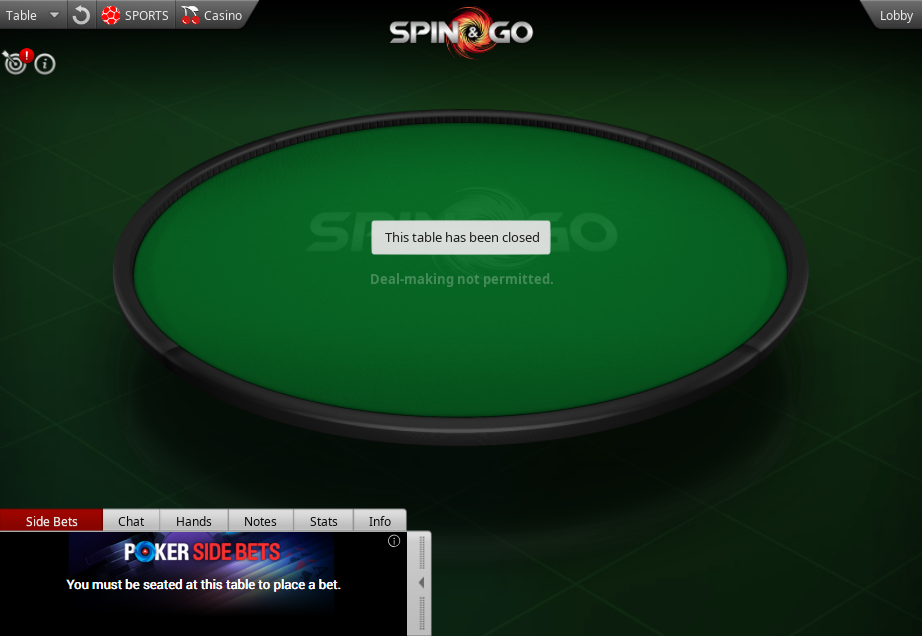

In [70]:
im

In [32]:
#it takes board number 1-6!! 
def screen_board(board_no):
        grab_displays = ((10,50,630,380),
        (650,50,1270,380),
        (1290,50,1910,380),
        (10,590,630,920),
        (650,590,1270,920),
        (1290,590,1910,920))
        #Screenshot of whole window number board-1
        return ImageGrab.grab(bbox=(grab_displays[board_no-1]))

#takes and returns a screenshot of given coords x1 y1 to x2 y2
def screenshot(xyxy): 
        return ImageGrab.grab(bbox=(xyxy))

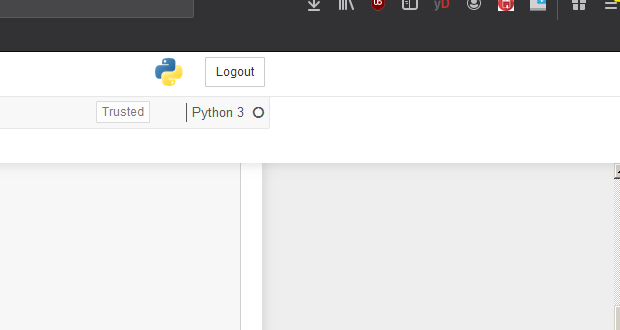

In [33]:
screen_board(3)

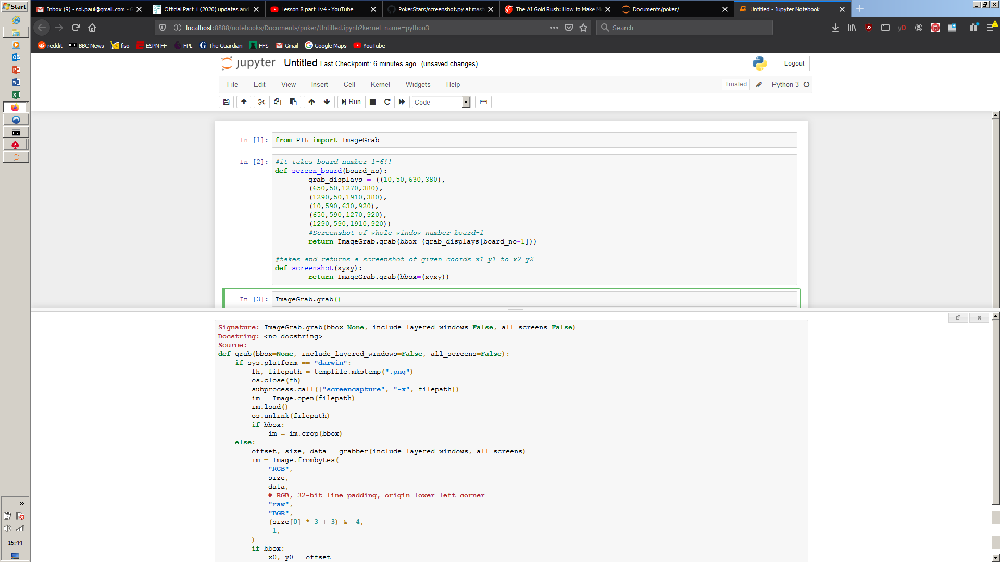

In [4]:
ImageGrab.grab()

In [80]:
s1=600
s2=600
s3=600
sb=50
bb=100
url = ('https://www.holdemresources.net/nashicm?action=calculate&s1=' + 
       str(s1) + '&s2=' + str(s2) + '&s3=' + str(s3) +
       '&p1=70&p2=30&p3=0&sb=' + str(sb) + '&bb=' + str(bb) + '&ante=0')

url

'https://www.holdemresources.net/nashicm?action=calculate&s1=600&s2=600&s3=600&p1=70&p2=30&p3=0&sb=50&bb=100&ante=0'

In [72]:
url = 'https://www.holdemresources.net/nashicm?action=calculate&s1=600&s2=600&p1=50&p2=30&p3=20&sb=50&bb=100&ante=0'

In [81]:
#Create a handle, page, to handle the contents of the website
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//table[@class="table m-0"]')

In [82]:
#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[2]:
    i+=1
    name=t.text_content()
#     print('%d:"%s"'%(i,name))
    col.append((name,[]))

In [96]:
ranges = re.sub(r'[\n\t]', '', col[1][0])
ranges

'BU31.2%, 22+ A2s+ A7o+ A5o-A3o K4s+ KTo+ Q7s+ QTo+ J7s+ JTo T7s+ 97s+ 87s SB8.4%, 77+ ATs+ ATo+ BB1.4%, QQ+ BB10.9%, 55+ A8s+ A9o+ SB72.5%, 22+ Kx+ Q2s+ Q3o+ J2s+ J7o+ T2s+ T6o+ 92s+ 96o+ 83s+ 86o+ 73s+ 75o+ 63s+ 65o 52s+ 54o 42s+ BB34.4%, 33+ Ax K4s+ K6o+ Q8s+ Q9o+ J9s+ JTo '

In [136]:
print('Button push range: ' + re.search('(?<=BU).+?(?= SB)', ranges).group())
print('Small blind call range: ' + re.search('(?<=SB).+?(?= BB)', ranges).group())
print('Big blind overcall range: ' + re.search('(?<=BB).+?(?= BB)', ranges).group())
print('Big blind call range: ' + re.search('(?<=BB).+?(?= SB)', re.search('(?<=BB).+', ranges).group()).group())
print('Small blind push range: ' + re.search('(?<=SB).+?(?= BB)', re.search('(?<=SB).+', ranges).group()).group())
print('Big blind call range: ' + re.search('(?<=BB).+', re.search('(?<=BB).+', re.search('(?<=BB).+', ranges).group()).group()).group())

Button push range: 31.2%, 22+ A2s+ A7o+ A5o-A3o K4s+ KTo+ Q7s+ QTo+ J7s+ JTo T7s+ 97s+ 87s
Small blind call range: 8.4%, 77+ ATs+ ATo+
Big blind overcall range: 1.4%, QQ+
Big blind call range: 10.9%, 55+ A8s+ A9o+
Small blind push range: 72.5%, 22+ Kx+ Q2s+ Q3o+ J2s+ J7o+ T2s+ T6o+ 92s+ 96o+ 83s+ 86o+ 73s+ 75o+ 63s+ 65o 52s+ 54o 42s+
Big blind call range: 34.4%, 33+ Ax K4s+ K6o+ Q8s+ Q9o+ J9s+ JTo 


In [51]:
from bs4 import BeautifulSoup
import requests 

with open(url) as html_file:
    soup = BeautifulSoup(html_file,'lxml')

tbody = soup.find('tbody',id='thetbody')

table_rows=tbody.find_all('tr')

for tr in table_rows:
    td = tr.find_all('td')
    row = [i.text for i in td]
    print(row)

OSError: [Errno 22] Invalid argument: 'https://www.holdemresources.net/nashicm?action=calculate&s1=600&s2=600&s3=600&p1=70&p2=30&p3=0&sb=50&bb=100&ante=0'

In [60]:
win32gui.GetWindowText(win32gui.GetForegroundWindow())

'Untitled - Jupyter Notebook - Mozilla Firefox'

In [5]:
ims = []

In [14]:
def windowEnumerationHandler(hwnd, top_windows):
    top_windows.append((hwnd, win32gui.GetWindowText(hwnd)))
    
# if __name__ == "__main__":
results = []
top_windows = []
win32gui.EnumWindows(windowEnumerationHandler, top_windows)
for i in top_windows:
    if "tournament" and "table" in i[1].lower():
        results.append(i)
        win32gui.ShowWindow(i[0],5)
        win32gui.SetForegroundWindow(i[0])
        time.sleep(0.2)
        ims.append(screenshot(i[1]))
#         break


In [6]:
def get_ranges(): None

def windowEnumerationHandler(hwnd, top_windows):
    top_windows.append((hwnd, win32gui.GetWindowText(hwnd)))
    
def get_tables(table_id=None):
    tables = []
    top_windows = []
    win32gui.EnumWindows(windowEnumerationHandler, top_windows)
    for i in top_windows:
        if "tournament" and "table" in i[1].lower():
            tables.append([i[0], i[1]])
            
    if table_id == None:
        if len(tables) == 0:
            print('No tables!')
        else: 
            return tables
    
    else:
        for table in tables:
            if table[0] == table_id:
                return table[1]
        
        print('Table no longer available')
        return False

active_window = get_tables()[0][0]
# print(active_window)

active_window_name = get_tables(active_window)[1]
# print(active_window_name)

while True:
#     win32gui.ShowWindow(active_window,5)
#     win32gui.SetForegroundWindow(active_window)
    
    active_window_name = get_tables(active_window)
    if not active_window_name: break

    blinds = list(map(int, re.search(r'\d+\/\d+', active_window_name).group().split('/')))
    print('Blinds are %d/%d' %(blinds[0], blinds[1]))
    print('Player 1 stack %d' % 600)
    print('Player 2 stack %d' % 600)
    print('Player 3 stack %d' % 600)
    print('Player 1 is the button')
#     display(screenshot(active_window_name))
    time.sleep(1)
    clear_output(wait=True)

Blinds are 20/40
Player 1 stack 600
Player 2 stack 600
Player 3 stack 600
Player 1 is the button


KeyboardInterrupt: 

In [54]:
active_window[1]

'$0.25 NLHE Spin & Go Flash - 40/80 - Tournament 2903168231 Table 1'

In [56]:
blinds = list(map(int, re.search(r'\d+\/\d+', active_window[1]).group().split('/')))
print('Blinds are %d/%d' %(blinds[0], blinds[1]))

Blinds are 40/80


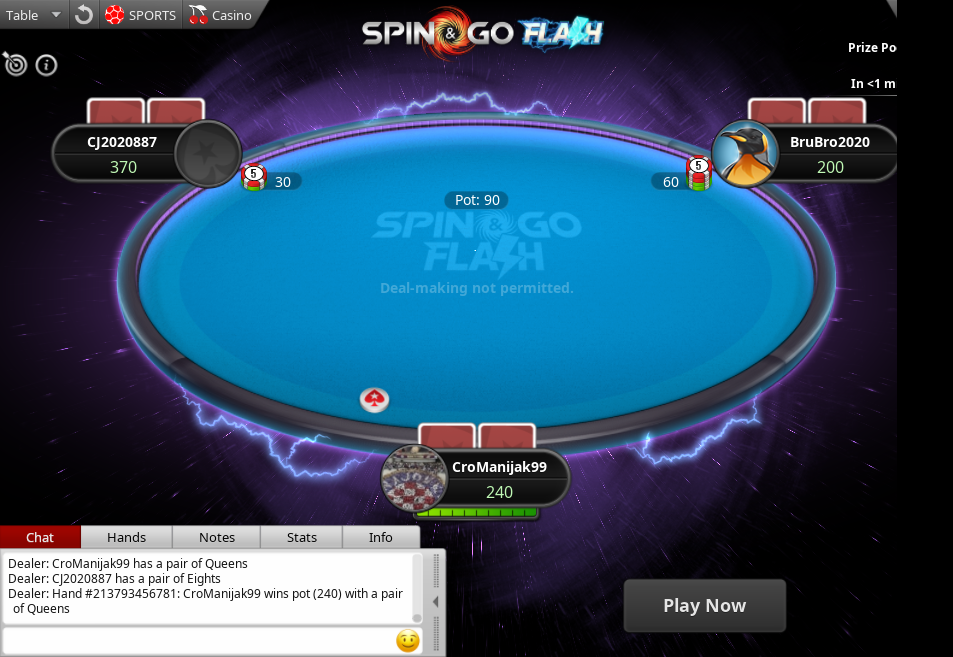

In [16]:
display(ims[1])

In [291]:
len(ims)

50

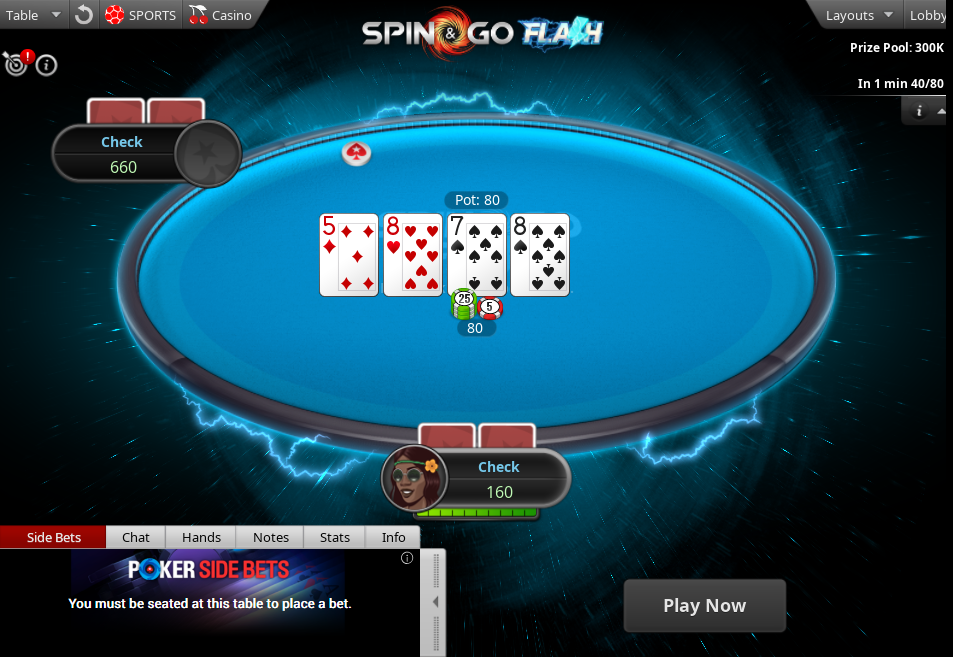

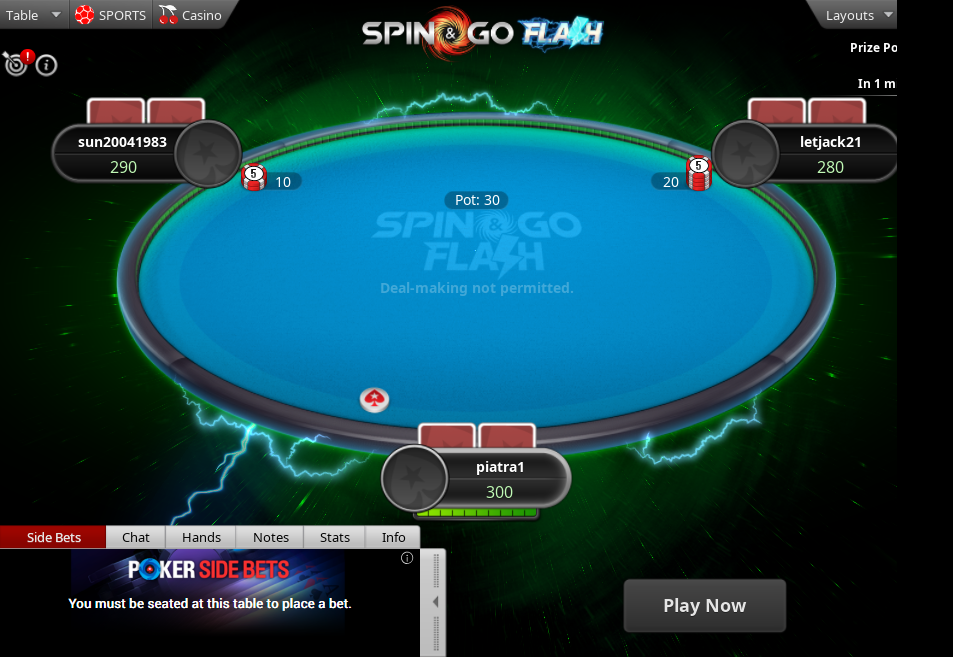

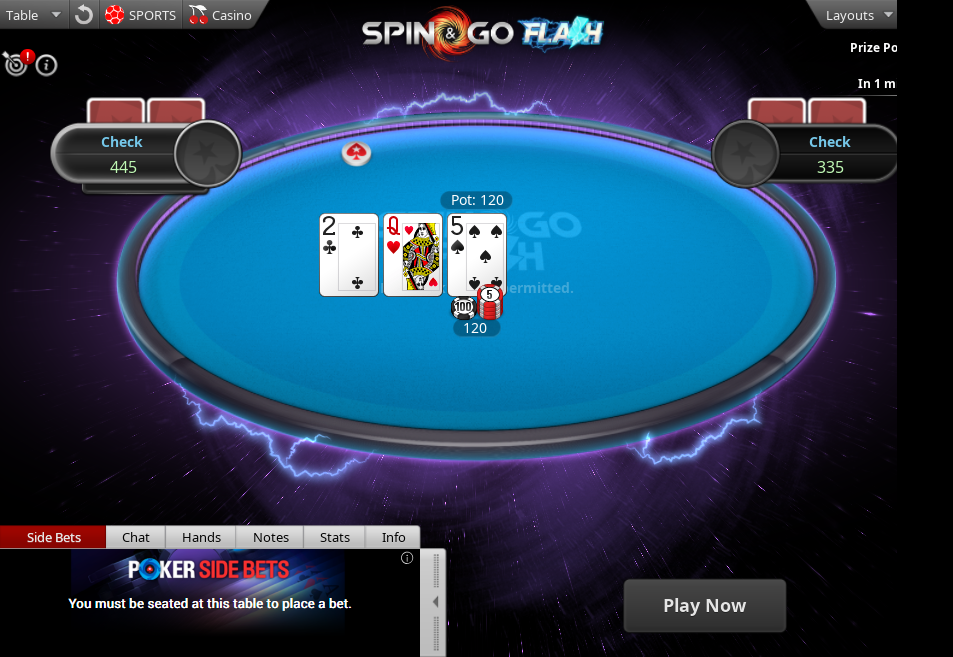

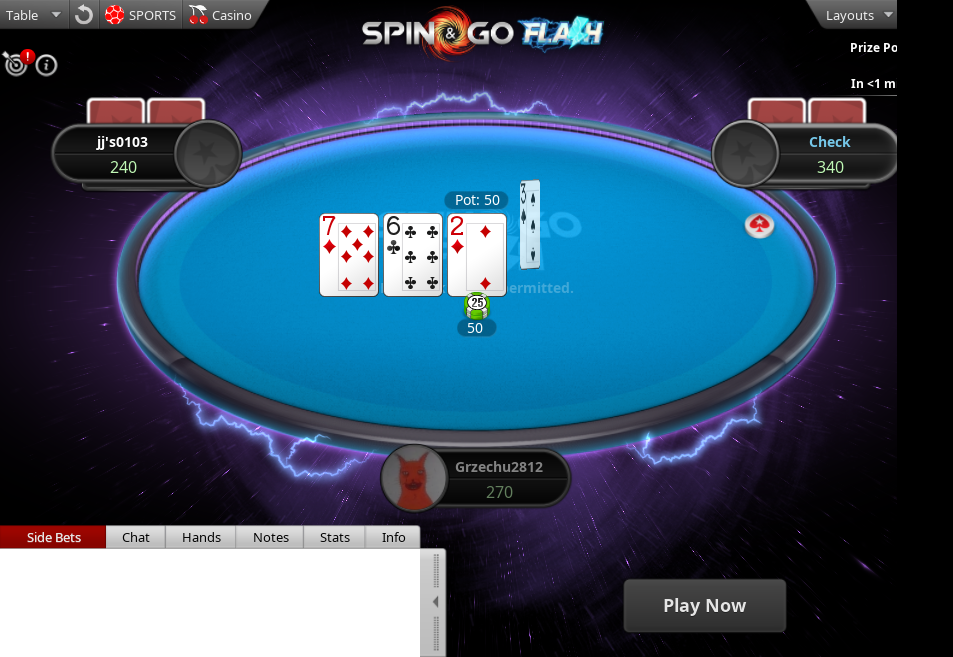

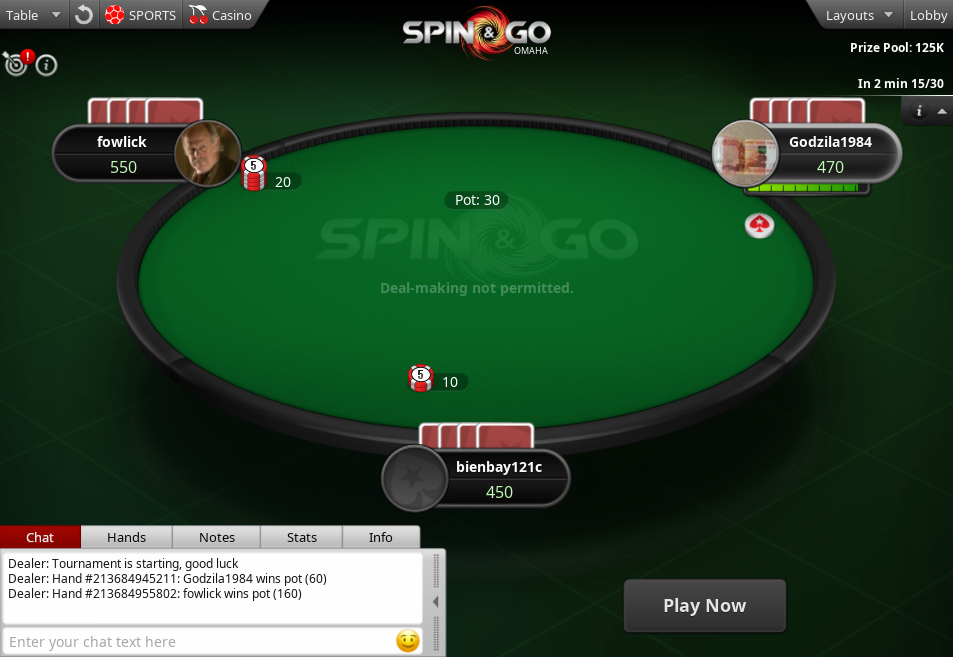

...

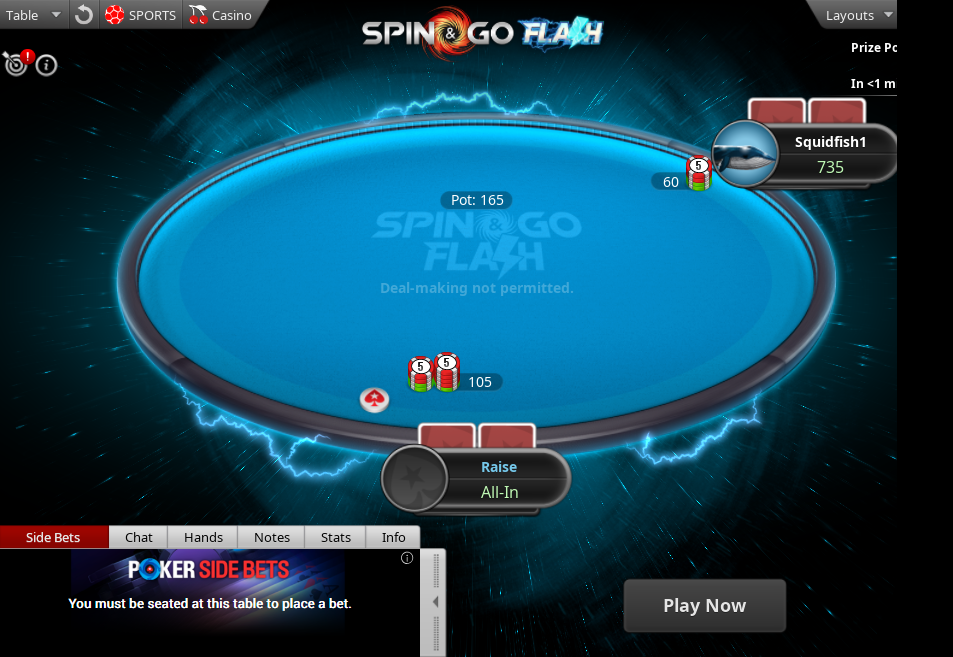

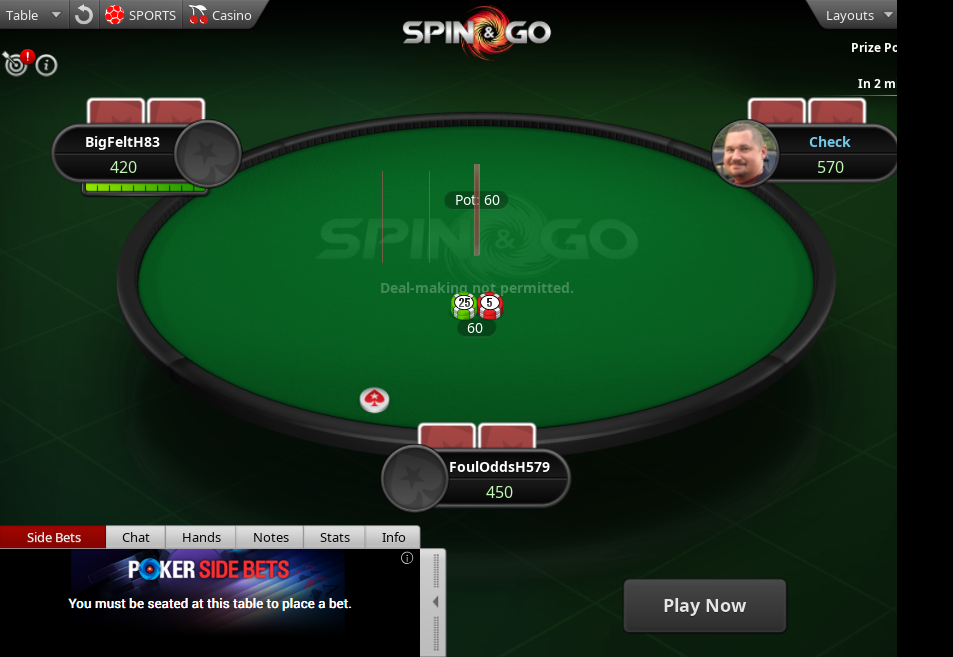

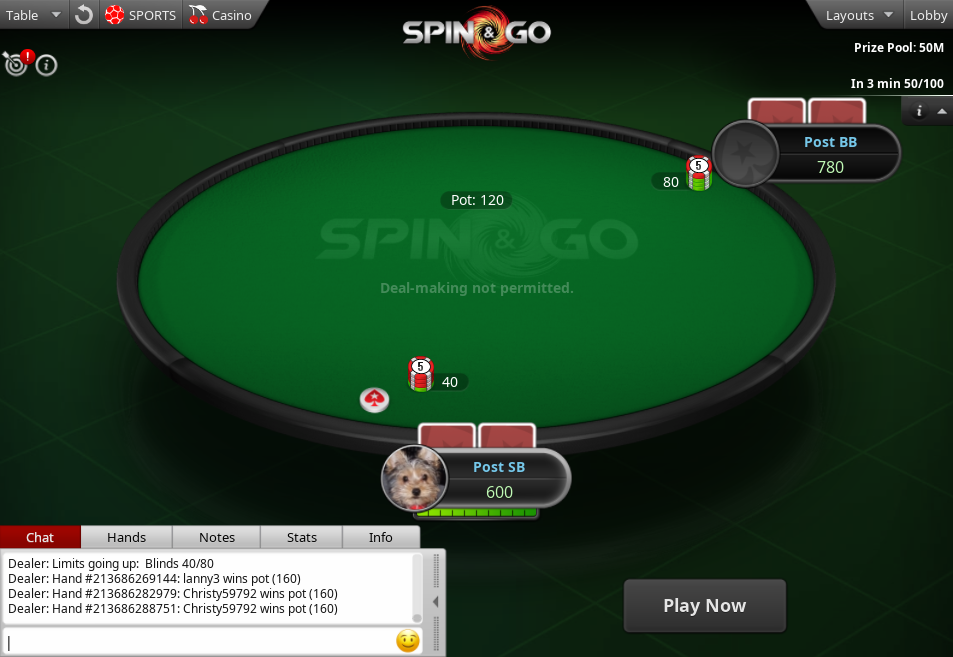

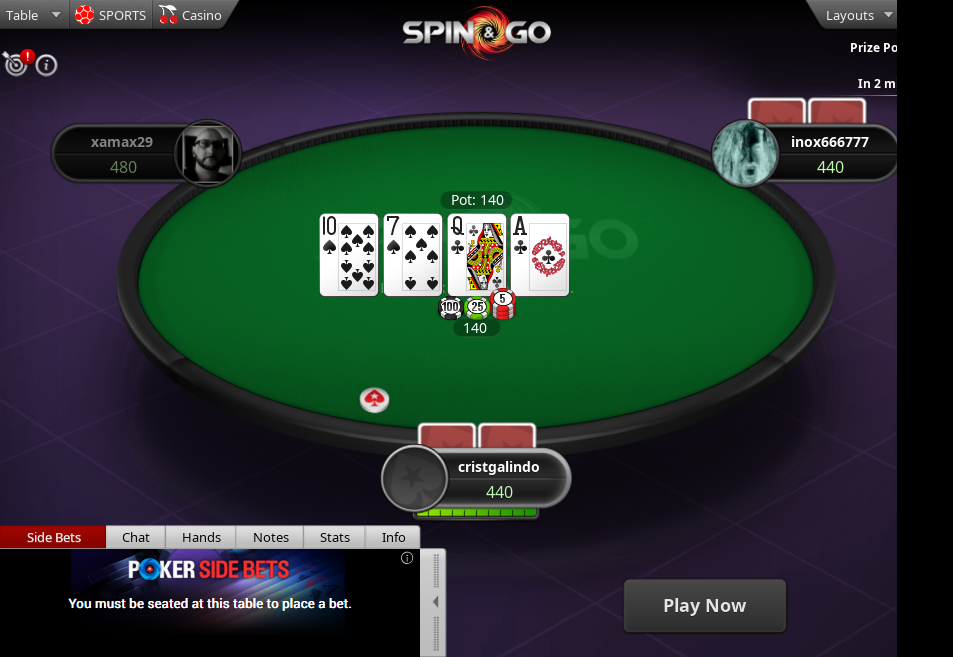

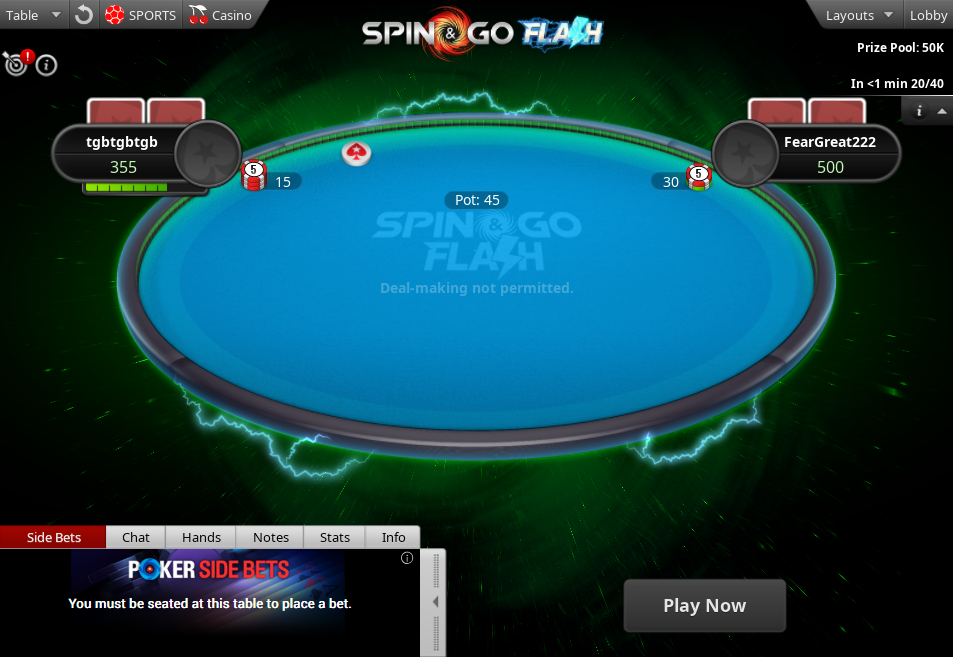

In [292]:
for im in ims:
    display(im)

# display(ims[7],ims[8],ims[9], ims[10])

In [303]:
for i in range(len(ims)):
    ims[i].save(f"image_{i}.png")

In [299]:
print(ims[0])

<PIL.Image.Image image mode=RGB size=953x657 at 0xD887848>


In [103]:
im = screenshot('PM 25000.00 NLHE Spin & Go Flash - 15/30 - Tournament 2900829253 Table 1')

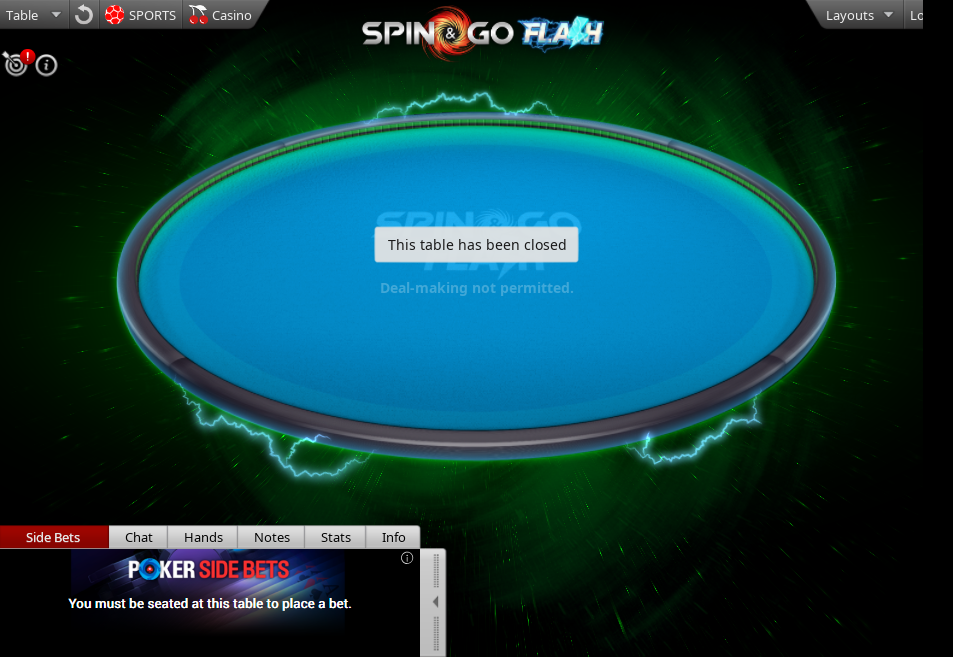

In [104]:
im